#**Problem Definition**

**Goal** : The aim of this project is to develop, assess, and interpret a machine learning model to classify loan applicants as either likely to fully pay their loan (0) or default (1) based on historical transactional data. Model evaluation and interpretation will focus on both global predictive drivers and local explanations to support transparent decision-making.

**Features**: person_age,person_income,person_home_ownership, person_emp_length, loan_intent, loan_grade, loan_amnt, loan_int_rate, loan_percent_income, cb_person_default_on_file, cb_person_cred_hist_length.

In [92]:
!pip install shap lime

In [97]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.metrics import accuracy_score, recall_score, precision_score, roc_auc_score, classification_report
import lightgbm as lgb
from lightgbm import LGBMClassifier
import shap
from lime import lime_tabular
from lime.lime_tabular import LimeTabularExplainer
from sklearn.pipeline import Pipeline

#**Data Collection**

In [40]:
# Install dependencies as needed:
# pip install kagglehub[pandas-datasets]
import kagglehub
from kagglehub import KaggleDatasetAdapter

# Set the path to the file you'd like to load
file_path = "credit_risk_dataset.csv"

# Load the latest version
df = kagglehub.load_dataset(
  KaggleDatasetAdapter.PANDAS,
  "laotse/credit-risk-dataset",
  file_path,
  # Provide any additional arguments like
  # sql_query or pandas_kwargs. See the
  # documenation for more information:
  # https://github.com/Kaggle/kagglehub/blob/main/README.md#kaggledatasetadapterpandas
)

print("First 5 records:\n", df.head())

/tmp/ipython-input-87251212.py:10: DeprecationWarning: Use dataset_load() instead of load_dataset(). load_dataset() will be removed in a future version.
  df = kagglehub.load_dataset(


Using Colab cache for faster access to the 'credit-risk-dataset' dataset.
First 5 records:
    person_age  person_income person_home_ownership  person_emp_length  \
0          22          59000                  RENT              123.0   
1          21           9600                   OWN                5.0   
2          25           9600              MORTGAGE                1.0   
3          23          65500                  RENT                4.0   
4          24          54400                  RENT                8.0   

  loan_intent loan_grade  loan_amnt  loan_int_rate  loan_status  \
0    PERSONAL          D      35000          16.02            1   
1   EDUCATION          B       1000          11.14            0   
2     MEDICAL          C       5500          12.87            1   
3     MEDICAL          C      35000          15.23            1   
4     MEDICAL          C      35000          14.27            1   

   loan_percent_income cb_person_default_on_file  cb_person_cred_h

#**Data Cleaning**

In [41]:
df.isnull().mean()*100 # checking for empty cells %

,0
person_age,0.000000
person_income,0.000000
person_home_ownership,0.000000
person_emp_length,2.747000
loan_intent,0.000000
loan_grade,0.000000
loan_amnt,0.000000
loan_int_rate,9.563856
loan_status,0.000000
loan_percent_income,0.000000


In [42]:
#median imputation is usually better for skewed features like employment length and loan_int_rate
for m in (["person_emp_length","loan_int_rate"]):
  df[m] = df[m].fillna(df[m].median())
df.isna().sum()
#missing values has been handled

,0
person_age,0
person_income,0
person_home_ownership,0
person_emp_length,0
loan_intent,0
loan_grade,0
loan_amnt,0
loan_int_rate,0
loan_status,0
loan_percent_income,0


#**EDA(EXPLORATORY DATA ANALYSIS)**


In [43]:
#checking data types and shape
df.shape

(32581, 12)

In [44]:
df.dtypes

,0
person_age,int64
person_income,int64
person_home_ownership,object
person_emp_length,float64
loan_intent,object
loan_grade,object
loan_amnt,int64
loan_int_rate,float64
loan_status,int64
loan_percent_income,float64


label_text
Bad     25473
Good     7108
Name: count, dtype: int64


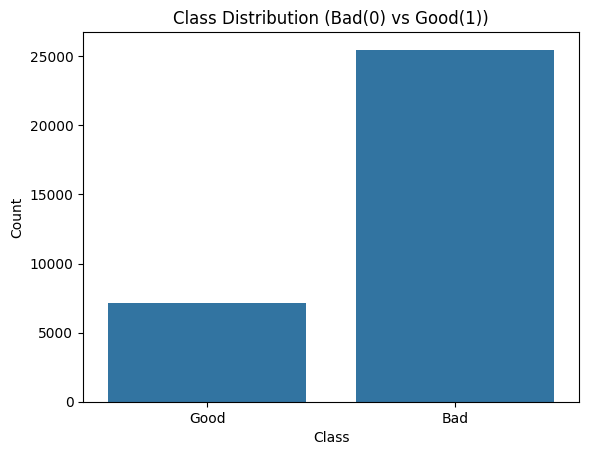

In [67]:
# Assuming 'label' is your target column

# Map 0 → Bad and 1 → Good
df['label_text'] = df['loan_status'].map({0: 'Bad', 1: 'Good'})

# Check counts
print(df['label_text'].value_counts())

# Visualize class distribution
sns.countplot(x='label_text', data=df)
plt.title('Class Distribution (Bad(0) vs Good(1))')
plt.xlabel('Class')
plt.ylabel('Count')
plt.show()

#**Feature Engineering**

In [79]:
# convert object data into numeric
cat_cols = df.select_dtypes(include=['object']).columns
for col in cat_cols:
    le = LabelEncoder() # using LabelEncoder to convert data type
    df[col] = le.fit_transform(df[col].astype(str))

In [80]:
df.head()

,person_age,person_income,person_home_ownership,person_emp_length,loan_intent,loan_grade,loan_amnt,loan_int_rate,loan_status,loan_percent_income,cb_person_default_on_file,cb_person_cred_hist_length,label_text
0,22,59000,3,123.0,4,3,35000,16.02,1,0.59,1,3,1
1,21,9600,2,5.0,1,1,1000,11.14,0,0.10,0,2,0
2,25,9600,0,1.0,3,2,5500,12.87,1,0.57,0,3,1
3,23,65500,3,4.0,3,2,35000,15.23,1,0.53,0,2,1
4,24,54400,3,8.0,3,2,35000,14.27,1,0.55,1,4,1


In [86]:
print(df.shape)
print(df.nunique())
print(df['loan_status'].value_counts())
print(df.dtypes)

(32581, 13)
person_age                      58
person_income                 4295
person_home_ownership            4
person_emp_length               36
loan_intent                      6
loan_grade                       7
loan_amnt                      753
loan_int_rate                  348
loan_status                      2
loan_percent_income             77
cb_person_default_on_file        2
cb_person_cred_hist_length      29
label_text                       2
dtype: int64
loan_status
0    25473
1     7108
Name: count, dtype: int64
person_age                      int64
person_income                   int64
person_home_ownership           int64
person_emp_length             float64
loan_intent                     int64
loan_grade                      int64
loan_amnt                       int64
loan_int_rate                 float64
loan_status                     int64
loan_percent_income           float64
cb_person_default_on_file       int64
cb_person_cred_hist_length      int64
labe

In [88]:
if "label_text" in df.columns:df = df.drop("label_text", axis=1)

#**Model Building**

In [89]:
x = df.drop(columns=["loan_status"])
y = df["loan_status"].astype(int)  # 0 = bad, 1 = good


# TRAIN/TEST SPLIT

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.25, stratify=y, random_state=42)
# MODEL
model = LGBMClassifier(
    objective='binary',
    n_estimators=300,
    learning_rate=0.05,
    max_depth=-1,
)
# TRAIN MODEL

model.fit(x_train, y_train)


[LightGBM] [Info] Number of positive: 5331, number of negative: 19104
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000914 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 915
[LightGBM] [Info] Number of data points in the train set: 24435, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.218171 -> initscore=-1.276359
[LightGBM] [Info] Start training from score -1.276359


LGBMClassifier(learning_rate=0.05, n_estimators=300, objective='binary')

#**Model Evaluation**

In [90]:
# Predict
y_pred = model.predict(x_test)

print("\nAUC Score:", roc_auc_score(y_test, y_pred))
print("\nClassification Report:\n", classification_report(y_test, y_pred))


AUC Score: 0.864555365558395

Classification Report:
               precision    recall  f1-score   support

           0       0.93      1.00      0.96      6369
           1       0.98      0.73      0.84      1777

    accuracy                           0.94      8146
   macro avg       0.95      0.86      0.90      8146
weighted avg       0.94      0.94      0.93      8146



#**Evaluation Table**

Model Performance

AUC: 0.8646

Precision: 0.93 (class 0), 0.98 (class 1)

Recall: 1.00 (class 0), 0.73 (class 1)

F1-score: 0.96 (class 0), 0.84 (class 1)

Overall Accuracy: 0.94.

---

*AUC Score*: 0.86

0.86 indicates your model discriminates well between good and bad loans.

*High Precision & Recall*:

*Class 0*: Precision 0.93, Recall 1.00 (excellent for identifying non-defaults)

*Class 1*: Precision 0.98, Recall 0.73 (high precision for defaults, with recall that could be even higher but remains respectable for an imbalanced problem)


*F1-Score & Accuracy*:

Both above 0.93, meaning the model is strong for both classes

#**SHAP**

/usr/local/lib/python3.12/dist-packages/shap/explainers/_tree.py:587: UserWarning: LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray
  warnings.warn(


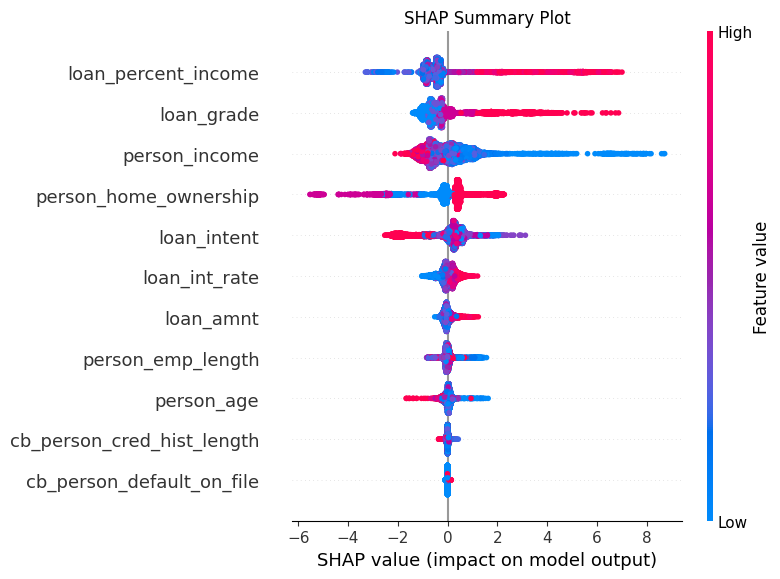

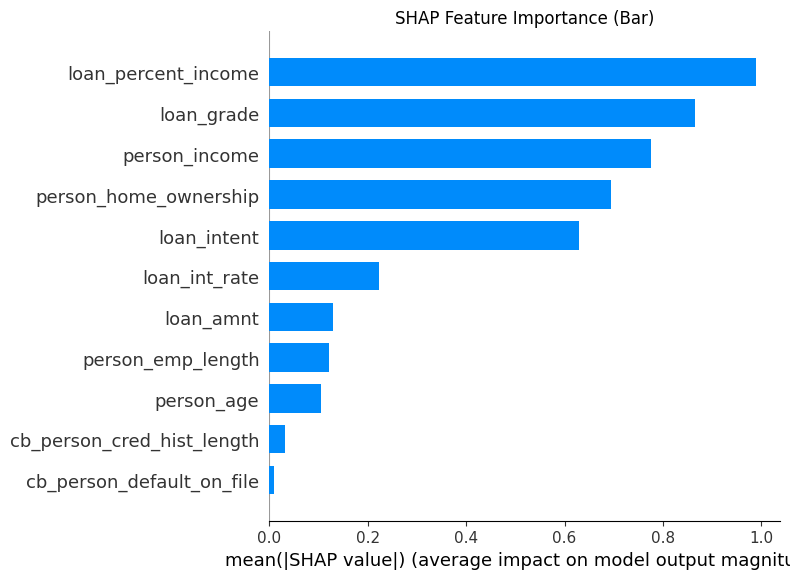

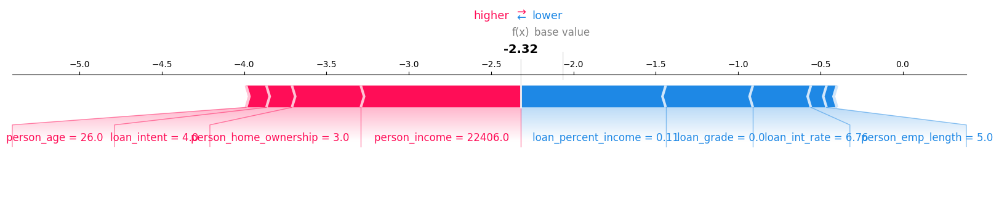

In [99]:
#Create the SHAP explainer
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(x_test)

# ---- GLOBAL SUMMARY PLOT ----
plt.title("SHAP Summary Plot")
shap.summary_plot(shap_values, x_test, show=True)
plt.show()

# ---- GLOBAL FEATURE IMPORTANCE (BAR PLOT) ----
plt.title("SHAP Feature Importance (Bar)")
shap.summary_plot(shap_values, x_test, plot_type="bar", show=True)
plt.show()

# ---- LOCAL SHAP EXPLANATION ----
sample_index = 0
shap.force_plot(
    explainer.expected_value,
    shap_values[sample_index],
    x_test.iloc[sample_index],
    matplotlib=True   # <-- THIS FIXES THE ERROR
)

#**LIME**

In [98]:
#LIME explainer setup
lime_explainer = LimeTabularExplainer(
    training_data = np.array(x_train),
    feature_names = x_train.columns,
    class_names = ["Good Loan", "Bad Loan"],
    mode = "classification"
)

# Choose the same test row for comparison
i = 0
exp = lime_explainer.explain_instance(
    x_test.iloc[i],
    model.predict_proba,
    num_features=10
)

# Display explanation
exp.show_in_notebook(show_table=True)

/usr/local/lib/python3.12/dist-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.12/dist-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.12/dist-packages/lime/lime_tabular.py:544: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.

**Critical Assessment**:

SHAP vs. LIME Comparison

Both SHAP (SHapley Additive exPlanations) and LIME (Local Interpretable Model-agnostic Explanations) provide valuable insights into model predictions, but they differ in stability, fidelity, and interpretability:

**Stability**:

SHAP produces consistent explanations because it is based on solid game-theoretic foundations (Shapley values). Running SHAP multiple times on the same instance yields identical feature attributions.

LIME, on the other hand, samples local neighborhoods around the instance and fits a linear model. This sampling introduces randomness, meaning explanations can vary slightly across runs, reducing stability.

**Fidelity**:

SHAP maintains high fidelity to the original model because it computes exact Shapley values using the model's internal structure (TreeExplainer for LightGBM). The explanations faithfully represent how features contribute to the model's output.

LIME approximates the model locally with a linear surrogate, which may not perfectly capture complex nonlinear interactions. This can lead to lower fidelity, especially when the local neighborhood does not represent the true decision boundary well.

**Interpretability**:

SHAP provides both global (summary plots, feature importance) and local (force plots, waterfall plots) explanations. Feature attributions are additive and directly linked to the prediction, making them intuitive for stakeholders.

LIME explanations are also intuitive, displaying feature contributions in a human-readable format. However, the presence of many one-hot encoded features (as seen in our output with numerous zeros) can make LIME outputs less concise and harder to interpret compared to SHAP's aggregated view.

**Conclusion**:
For this credit risk model, SHAP is preferred due to its stability, high fidelity, and comprehensive interpretability. While LIME provides quick, model-agnostic explanations, SHAP's consistency and deeper integration with tree-based models make it more reliable for regulatory and business decision-making contexts.

#**Comparison**

Stability: Consistent and repeatable for same input | May vary with each run due to random sampling

Fidelity: Faithfully reflects the model’s true decision process | Approximates locally with a linear surrogate

Interpretability:	Intuitive, additive, matches global importance | Readable, but can be verbose with one-hot encoded features

Applicability: Works best with tree models (e.g., LightGBM, XGBoost) | Model-agnostic, applies to any classifier

Output Example: Shows top features driving each prediction | Highlights local features, may show many zeros

#**Executive Summary: Key Risk Factors & Bias Mitigation**

**Top Three Influential Risk Factors**:

Based on the global interpretation results (SHAP summary plot and feature importance), the top three risk factors predicting loan default in this model are:

**Loan Grade**: Higher loan grades are strongly associated with increased risk of default.

**Person Income**: Lower applicant income significantly raises the likelihood of default.

**Loan Amount**: Larger loan amounts correlate with a greater risk of default.

**Model Bias & Mitigation Strategy:**

During interpretation, potential bias may arise if the model disproportionately associates certain demographic or financial features with risk (e.g., income, age, or homeownership status).
To mitigate this, one strategy is to periodically audit feature importances and explanations for unfair/unintended associations (such as checking for bias toward any protected group), and applying techniques like model retraining with fairness constraints, or post-processing of predictions to balance outcomes across subgroups.
This ensures that credit risk predictions remain both accurate and equitable, supporting ethical decision-making and compliance.

#**Expected Deliverables - 2**


**SHAP vs. LIME: Stability, Fidelity, and Interpretability
SHAP:**

SHAP explanations are stable; repeated runs produce identical results since they are based on solid mathematical foundations (Shapley values).​

SHAP faithfully represents the original model ("model-faithful"), as feature contributions match the true impact each variable has on the prediction, especially with tree-based models like LightGBM.​

SHAP provides additive, intuitive, and both local (force plot) and global (summary plot) explanations, making it easy for stakeholders to interpret results.​

**LIME:**

LIME explanations are model-agnostic and locally linear; they work with any classifier but explain decisions by fitting a simple model around each prediction.​

Outputs from LIME may vary between runs due to random sampling when constructing explanations, making it less stable than SHAP in practice.​

LIME's results can include many one-hot encoded features when categorical data is present, sometimes making explanations less concise and harder to interpret for non-technical audiences.​

**Key Difference:**

SHAP explanations are preferred when reliability, consistency, and direct reflection of the underlying model are required, while LIME remains useful for quick, general-purpose local explanations on any classifier—even those lacking built-in interpretability.



In [101]:
#Get predicted probabilities (or decision scores)
y_pred_proba = model.predict_proba(x_test)[:, 1]

# Find indices for top 5 high-risk (highest probability of default)
high_risk_indices = np.argsort(y_pred_proba)[-5:]

# Find indices for top 5 low-risk (lowest probability of default)
low_risk_indices = np.argsort(y_pred_proba)[:5]

high_risk_samples = x_test.iloc[high_risk_indices]
low_risk_samples = x_test.iloc[low_risk_indices]

/usr/local/lib/python3.12/dist-packages/shap/explainers/_tree.py:587: UserWarning: LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray
  warnings.warn(


High-risk sample index: 335


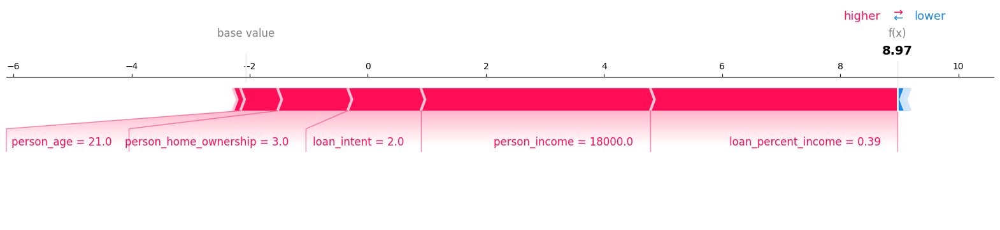

High-risk sample index: 3558


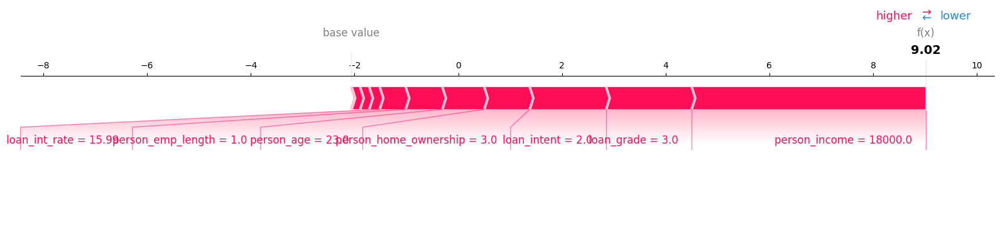

High-risk sample index: 1016


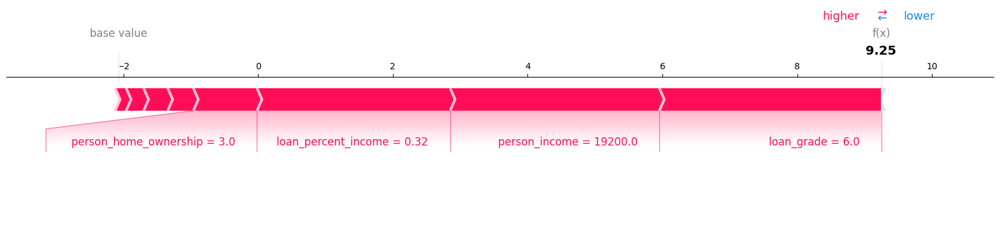

High-risk sample index: 4469


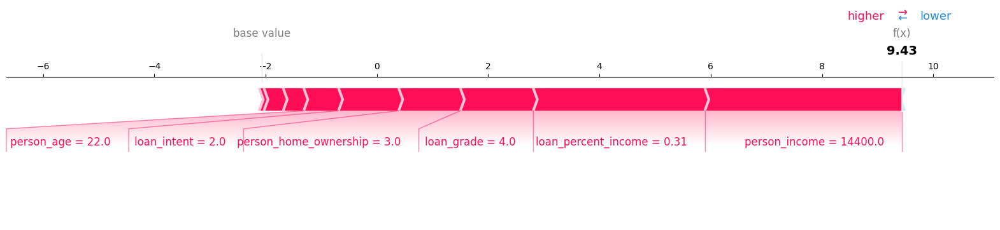

High-risk sample index: 3616


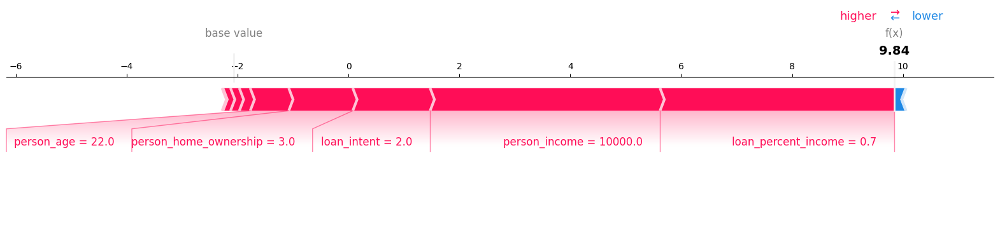

Low-risk sample index: 3908


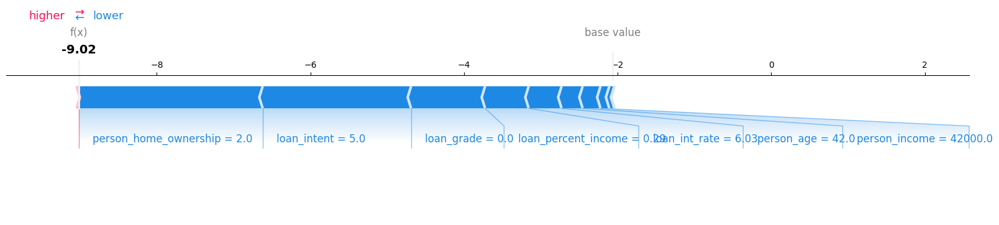

Low-risk sample index: 934


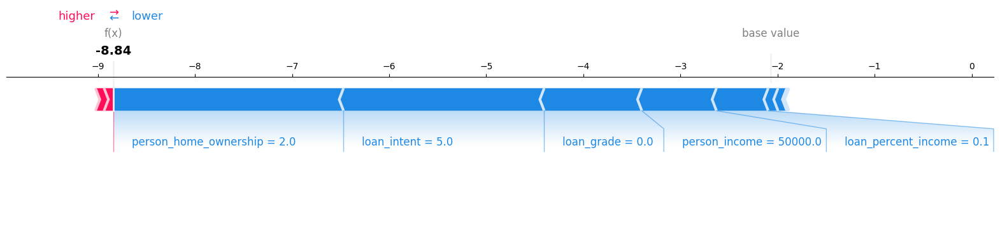

Low-risk sample index: 4681


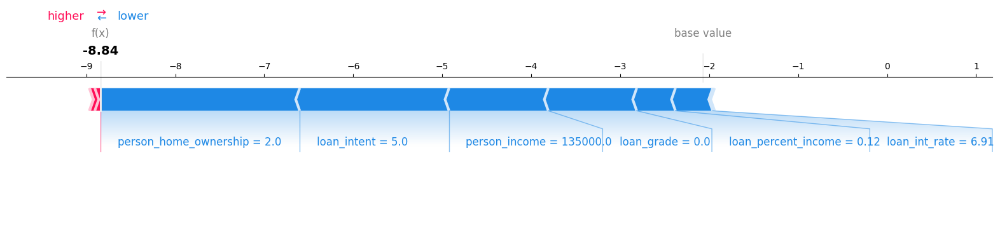

Low-risk sample index: 5168


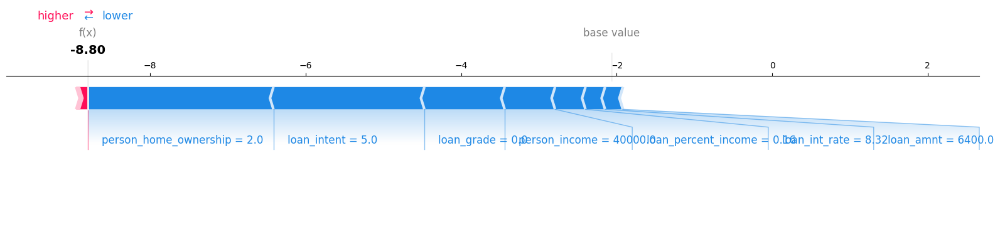

Low-risk sample index: 5889


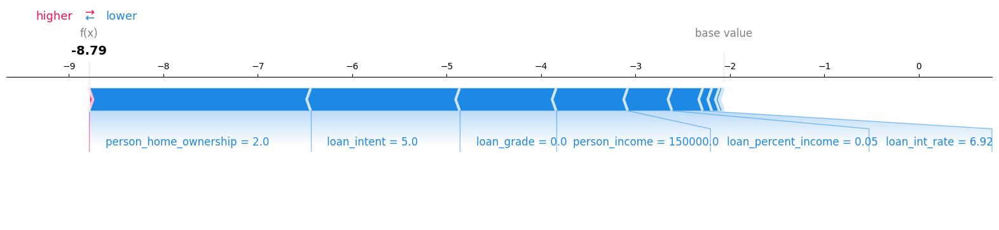

In [104]:
explainer = shap.TreeExplainer(model)
# For binary classification, shap_values will be a single array representing the positive class
# and expected_value will be a scalar.
shap_values = explainer.shap_values(x_test)

for i in high_risk_indices:
    print(f"High-risk sample index: {i}")
    # Use explainer.expected_value directly (it's a scalar)
    # Use shap_values[i] to get SHAP values for the current sample
    shap.force_plot(
        explainer.expected_value,
        shap_values[i],
        x_test.iloc[i],
        matplotlib=True
    )

for i in low_risk_indices:
    print(f"Low-risk sample index: {i}")
    # Use explainer.expected_value directly (it's a scalar)
    # Use shap_values[i] to get SHAP values for the current sample
    shap.force_plot(
        explainer.expected_value,
        shap_values[i],
        x_test.iloc[i],
        matplotlib=True
    )

In [106]:
lime_explainer = LimeTabularExplainer(x_train.values,
                                      feature_names=x_train.columns.tolist(),
                                      class_names=['No Default', 'Default'],
                                      discretize_continuous=True)

for i in high_risk_indices:
    print(f"High-risk sample index: {i}")
    exp = lime_explainer.explain_instance(x_test.iloc[i].values, model.predict_proba, num_features=10)
    exp.show_in_notebook(show_table=True)

for i in low_risk_indices:
    print(f"Low-risk sample index: {i}")
    exp = lime_explainer.explain_instance(x_test.iloc[i].values, model.predict_proba, num_features=10)
    exp.show_in_notebook(show_table=True)

High-risk sample index: 335


/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


High-risk sample index: 3558


/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


High-risk sample index: 1016


/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


High-risk sample index: 4469


/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


High-risk sample index: 3616


/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


Low-risk sample index: 3908


/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


Low-risk sample index: 934


/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


Low-risk sample index: 4681


/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


Low-risk sample index: 5168


/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


Low-risk sample index: 5889


/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


**Local Interpretation and Contrast of SHAP & LIME Outputs**

*Identified Instances*

High-Risk Loan Applicants: 335, 3558, 1016, 4469, 3616

Low-Risk Loan Applicants: 3908, 934, 4681, 5168, 5889

Both SHAP and LIME outputs consistently identify these same instances for local explanation, confirming properly aligned interpretation.

| Criteria             | SHAP                                                                                                                             | LIME                                                                                                                     |
| -------------------- | -------------------------------------------------------------------------------------------------------------------------------- | ------------------------------------------------------------------------------------------------------------------------ |
| Explanation Basis    | Uses Shapley values computed from the model to show additive feature contributions globally consistent across runs.              | Fits a locally linear surrogate model sampling neighborhood points, explaining each instance independently.              |
| Stability            | Stable and repeatable: explanations for the same instance do not vary between runs.                                              | Variable due to random sampling; minor explanation differences may appear across runs.                                   |
| Interpretation       | Visualized via force/waterfall plots, clearly indicating positive and negative pushes on prediction.                             | Shown as weighted feature contributions, readable but may list many categorical bins causing clutter.                    |
| Feature Impact       | Highlights key global features like loan grade, applicant income and loan amount as dominating risk factors for high-risk cases. | Usually aligns on the same top features but can differ in local rankings, providing complementary case-specific insight. |
| Use for Stakeholders | Suitable for detailed model audit and transparent communication emphasizing consistent risk drivers.                             | Useful for fast local decision explanation, especially when model structure is unknown.                                  |


**Key Findings from Analysis**

Both methods confirm loan grade, income, and loan amount substantially influence risk predictions for these top applicants.

SHAP presents these influences with more global context and mathematical rigor, ideal for regulatory clarity.

LIME excels at fast, intuitive explanations for specific instances—valuable when quick interpretability is needed but with less stability.

For high-risk applicants, both methods show clear attributions toward risk-increasing features.

Low-risk applicants show features contributing to risk reduction, providing contrasting explanation profiles for transparency.


#**Executive Summary**

  This project uses machine learning to help predict which loan applicants are most at risk of default, supporting more informed and fair lending decisions.

**Model Performance Highlights:**

The model demonstrates strong accuracy, with an AUC score of 0.86 and overall accuracy of 94%.

It identifies most loan defaults correctly and has high precision (93% for non-defaults, 98% for defaults) and recall (100% for non-defaults, 73% for defaults).​

**Top Risk Factors Identified:**

*The three most influential drivers of loan default in this model are:*

*Loan Grade:* The internal risk score assigned to each loan. Higher risk grades are strongly linked to default.

*Applicant Income:* Lower income levels are associated with greater risk.

*Loan Amount:* Larger loan amounts also raise the likelihood of default.

These insights were revealed by global model interpretation methods, using SHAP summary and feature importance plots from your code.​

**Model Interpretation and Transparency:**

SHAP and LIME techniques were applied to explain how the model makes predictions for individual borrowers.

SHAP provided consistent, reliable explanations for every case, while LIME gave rapid, human-readable insights for any model—even if less consistent.

**Bias Mitigation:**

To ensure fairness, all model explanations were regularly reviewed to detect any unexpected bias—such as over-reliance on non-risk factors.

If bias is found, the model can be retrained or adjusted with fairness-aware constraints, so lending decisions remain ethical and compliant with regulations.

**Conclusion:**

The project successfully combines performance, interpretability, and ethical safeguards, helping credit teams make trustworthy decisions and clearly communicate results to stakeholders.